# This file contains the code for the different data augmentation techniques that are used in our project

In [2]:
import pandas as pd
import numpy as np
import os

import librosa
import librosa.display
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder 

In [3]:
data_path = pd.read_csv('data_path.csv')
data_path.head()

,Emotions,Path
0,male_neutral,Ravdess\03-01-01-01-01-01-01.wav
1,female_neutral,Ravdess\03-01-01-01-01-01-02.wav
2,male_neutral,Ravdess\03-01-01-01-01-01-03.wav
3,female_neutral,Ravdess\03-01-01-01-01-01-04.wav
4,male_neutral,Ravdess\03-01-01-01-01-01-05.wav


In [4]:
print(data_path.Emotions.value_counts())

Emotions
female_happy       1096
female_sad         1096
female_angry       1096
female_fear        1096
female_disgust     1096
female_neutral      960
male_happy          767
male_sad            767
male_angry          767
male_fear           767
male_disgust        767
male_neutral        623
female_surprise     496
male_calm            96
female_calm          96
male_surprise        96
Name: count, dtype: int64


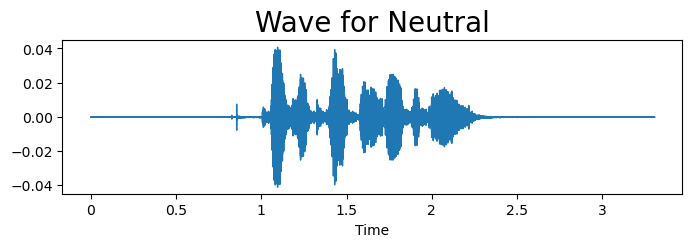

In [5]:
data_neutral, sr_neutral = librosa.load(os.getcwd() + '\\wav_file\\'+data_path['Path'][0])
#Wave plot of the Neutral emotions
plt.figure(figsize=(8,2))
plt.title('Wave for Neutral', size=20)
librosa.display.waveshow(data_neutral, sr=sr_neutral)

In [6]:
# Defining a function that allows us to add "noise" to each audio file
# By doing this, we hope to make the model more robust to background noise and in that sense, make it more generalizable

def add_noise(data):
    rand_amp = 0.02 * np.random.uniform() * np.amax(data) # Random amplitude, value: 0.02 is randomly chosen and can be fine tuned
    data = data + rand_amp * np.random.normal(size=data.shape[0]) # Adding noise to the data
    return data

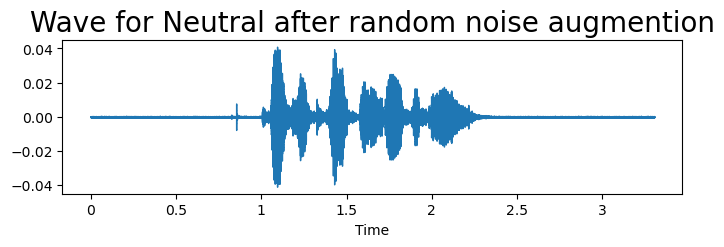

In [7]:
aug_data_neutral = add_noise(data_neutral)
plt.figure(figsize=(8,2))
plt.title('Wave for Neutral after random noise augmention', size=20)
librosa.display.waveshow(aug_data_neutral, sr=sr_neutral)

In [8]:
# Next function that we want to define is one that allows us to randomly shift the audio files left or right
# This is because for the data, it is professionally recorded and all the audio files start at similar timings
# By adding this variation to start timings, we hope to make the model less prone to overfitting to the data

def shift_audio(data):
    rand_shift = int(np.random.uniform(low = -5, high = 5) * 500) # value for the shift can be fine tuned
    # with the use of numpy roll, the shifted values at the front will flow to the back. Need to take note of this as it might affect the meaning of the sentence if that happens
    return np.roll(data, rand_shift)

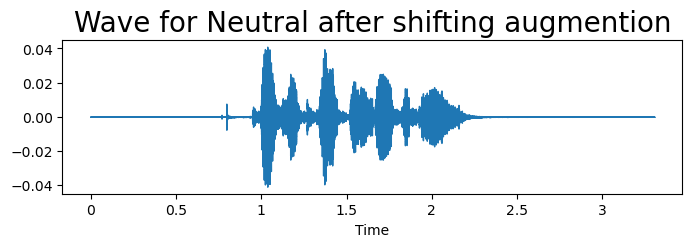

In [9]:
aug_data_neutral = shift_audio(data_neutral)
plt.figure(figsize=(8,2))
plt.title('Wave for Neutral after shifting augmention', size=20)
librosa.display.waveshow(aug_data_neutral, sr=sr_neutral)

In [10]:
# Next function is to randomly stretch the audio file
# by stretching the audio file, we are mimicing the audio being spoken slower or faster

def stretch_audio(data):
    rand_rate = np.random.uniform(low = 0.96, high = 1.04) # stretch rate cannot be too high or low as it will after the how the waves are interpreted
    return librosa.effects.time_stretch(data, rate=rand_rate)

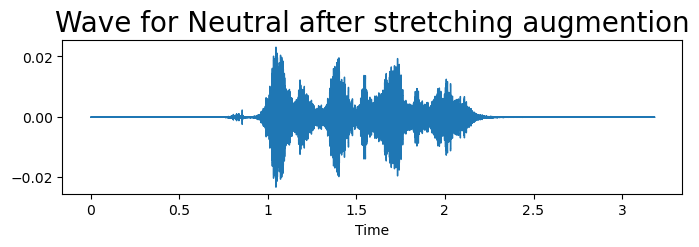

In [11]:
aug_data_neutral = stretch_audio(data_neutral)
plt.figure(figsize=(8,2))
plt.title('Wave for Neutral after stretching augmention', size=20)
librosa.display.waveshow(aug_data_neutral, sr=sr_neutral)

In [12]:
def feature_extraction_mfcc(data, sample_rate):
    # Extract features from the audio
    mfcc = np.mean(librosa.feature.mfcc(y=data, sr=sample_rate).T, axis=0)
    return mfcc

def feature_extraction_sc(data, sample_rate):
    # Extract features from the audio
    spectral_contrast = np.mean(librosa.feature.spectral_contrast(y=data, sr=sample_rate).T,axis=0)
    return spectral_contrast

def feature_extraction_chroma(data, sample_rate):
    # Extract features from the audio
    chroma = np.mean(librosa.feature.chroma_stft(y=data, sr=sample_rate).T,axis=0)
    return chroma

def feature_extraction_mel(data, sample_rate):
    # Extract features from the audio
    mel = np.mean(librosa.feature.melspectrogram(y=data, sr=sample_rate).T,axis=0)
    return mel

def feature_extraction_tonnetz(data, sample_rate):
    # Extract features from the audio
    tonnetz = np.mean(librosa.feature.tonnetz(y=data, sr=sample_rate).T,axis=0)
    return tonnetz

In [13]:
# Please change the path to the correct path!!! Don't copy blindly
cwd = os.getcwd() + '\\wav_file\\'

In [14]:
# Loop through all WAV files and do data augmentation on it followed by feature extraction

results = []
# print(cwd+data_path['Path'][0])

for file in data_path['Path']:
    initial = {}
    path = cwd + file

    # load audio file
    data, sample_rate = librosa.load(path)

    # Do data augmentation (Order of augmentation is Add noise, Stretch, Shift)
    data = add_noise(data)
    data = stretch_audio(data)
    data = shift_audio(data)

    # Extract features
    mfcc = feature_extraction_mfcc(data, sample_rate)
    sc = feature_extraction_sc(data, sample_rate)
    chroma = feature_extraction_chroma(data, sample_rate)
    mel = feature_extraction_mel(data, sample_rate)
    tonnetz = feature_extraction_tonnetz(data, sample_rate)

    # Add the features to the dictionary
    initial['MFCC'] = mfcc
    initial['Spectral Contrast'] = sc
    initial['Chroma'] = chroma
    initial['Mel'] = mel
    initial['Tonnetz'] = tonnetz

    results.append(initial)

print(results)


c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=1019
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=1023
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=792
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=817
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=768
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=634
  warnings.warn(
c:\Users\zongw\anaconda3\Lib\site-packages\librosa

[{'MFCC': array([-5.23529545e+02,  2.72419890e+01,  5.76978744e+00,  9.27940191e+00,
        5.08921759e+00, -2.39032823e+00, -4.39578390e+00, -5.87570495e+00,
       -8.97819509e+00, -5.32530134e+00, -4.04276308e-02, -5.75571655e-01,
       -1.16032425e+00, -2.07329325e+00, -1.42552018e+00, -2.22732629e+00,
       -3.43756666e+00, -3.53774662e+00, -1.61182704e+00, -2.36115138e+00]), 'Spectral Contrast': array([16.50040324, 12.45286671, 15.63301986, 14.59455565, 15.08305756,
       15.33029681, 14.35287788]), 'Chroma': array([0.69933018, 0.68526808, 0.630349  , 0.63106821, 0.63322972,
       0.5465623 , 0.56671568, 0.59504563, 0.61462717, 0.61388839,
       0.594774  , 0.59727852]), 'Mel': array([9.28219318e-06, 2.79973082e-05, 9.99084476e-04, 8.91094511e-03,
       1.66867936e-02, 1.32942030e-02, 2.04981591e-03, 1.41543546e-02,
       1.71989146e-02, 8.85430078e-03, 9.91748573e-03, 4.82630332e-03,
       3.25002296e-03, 3.23729624e-03, 6.48730876e-03, 1.67137464e-02,
       1.83932372

In [15]:
features_df = pd.DataFrame(results)
mfcc_df = pd.DataFrame(features_df['MFCC'].tolist())
mfcc_df.columns = ['MFCC' + str(x) for x in range(len(mfcc_df.columns))]
sc_df = pd.DataFrame(features_df['Spectral Contrast'].tolist())
sc_df.columns = ['Spectral Contrast' + str(x) for x in range(len(sc_df.columns))]
chroma_df = pd.DataFrame(features_df['Chroma'].tolist())
chroma_df.columns = ['Chroma' + str(x) for x in range(len(chroma_df.columns))]
mel_df = pd.DataFrame(features_df['Mel'].values.tolist())
mel_df.columns = ['Mel' + str(x) for x in range(len(mel_df.columns))]
tonnetz_df = pd.DataFrame(features_df['Tonnetz'].tolist())
tonnetz_df.columns = ['Tonnetz' + str(x) for x in range(len(tonnetz_df.columns))]

df_final = pd.concat([data_path, mfcc_df, sc_df, chroma_df, mel_df, tonnetz_df], axis=1)

In [16]:
label_encoder = LabelEncoder()
df_final['Emotions'] = label_encoder.fit_transform(df_final['Emotions'])
df_final


,Emotions,Path,MFCC0,MFCC1,MFCC2,MFCC3,MFCC4,MFCC5,MFCC6,MFCC7,...,Mel124,Mel125,Mel126,Mel127,Tonnetz0,Tonnetz1,Tonnetz2,Tonnetz3,Tonnetz4,Tonnetz5
0,13,Ravdess\03-01-01-01-01-01-01.wav,-523.529545,27.241989,5.769787,9.279402,5.089218,-2.390328,-4.395784,-5.875705,...,0.000014,0.000014,1.288731e-05,1.067009e-05,-0.011892,0.014680,-0.037830,0.012758,0.002293,0.000711
1,5,Ravdess\03-01-01-01-01-01-02.wav,-496.500553,24.471357,-4.290021,-0.117138,-4.133275,-5.330633,-6.086381,-8.918441,...,0.000019,0.000019,1.951147e-05,1.724507e-05,-0.025786,0.017141,0.024213,-0.013041,0.001195,0.011456
2,13,Ravdess\03-01-01-01-01-01-03.wav,-493.828069,30.269077,0.099546,3.565363,1.506498,-3.990596,-9.876523,-5.602124,...,0.000035,0.000047,3.442724e-05,1.579058e-05,0.006586,-0.017492,0.010258,0.021191,0.001935,-0.012934
3,5,Ravdess\03-01-01-01-01-01-04.wav,-530.041269,19.985562,-2.764032,1.729861,-3.209140,-3.402472,-4.917748,-10.306199,...,0.000019,0.000015,1.158044e-05,9.503128e-06,-0.001818,0.001853,-0.001479,-0.022831,-0.008600,-0.004256
4,13,Ravdess\03-01-01-01-01-01-05.wav,-665.081016,51.012514,9.008959,12.308820,7.629854,-0.913261,-1.587498,-3.771605,...,0.000001,0.000001,8.860940e-07,2.348652e-07,-0.007477,0.020805,-0.052498,0.015439,0.011113,0.002884
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11677,6,Tess\YAF_sad\YAF_witch_sad.wav,-389.124163,47.027785,37.146147,37.108588,-0.671773,6.422809,-0.692704,-9.356516,...,0.003061,0.005636,3.271901e-03,3.413719e-04,-0.044748,0.011061,-0.057861,0.063290,-0.028197,0.014454
11678,6,Tess\YAF_sad\YAF_yearn_sad.wav,-350.109627,49.143819,28.563206,25.172961,4.201832,-0.417140,-7.534870,-9.986752,...,0.006179,0.003649,1.614662e-03,2.520907e-04,-0.006275,0.104968,-0.081773,0.046292,0.017825,-0.033756
11679,6,Tess\YAF_sad\YAF_yes_sad.wav,-312.366000,42.180737,33.968175,23.513305,3.395974,1.075264,-2.698125,-5.581010,...,0.006236,0.004199,1.652124e-03,4.549844e-04,-0.030584,-0.012431,-0.126788,0.090050,-0.005925,0.004090
11680,6,Tess\YAF_sad\YAF_young_sad.wav,-358.363965,40.701249,26.351781,23.244979,4.408308,4.779110,-1.806534,-7.885992,...,0.003005,0.003298,1.828172e-03,2.166379e-04,-0.054344,-0.029527,-0.047386,0.033372,-0.059989,0.022592


In [17]:
df_final.to_csv('aug_final_df.csv', index=False)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=0b28ef1e-f6a6-4523-8903-70adcffed1c5' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>